In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Set a style for the plots
plt.style.use('seaborn-v0_8-whitegrid')
print("Setup complete.")

#command: python dataset_sample-forw_back.py --num_samples 4 --batch_size 2


Setup complete.


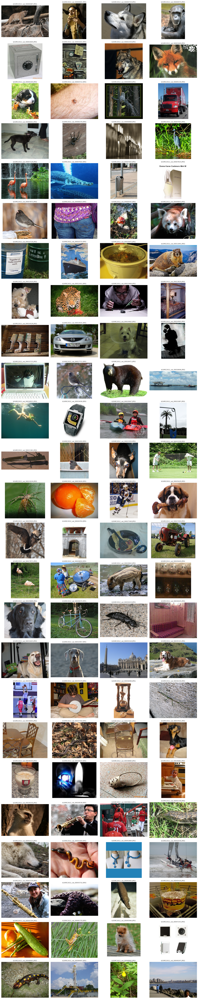

In [2]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

folder = "/work/pcsl/Noam/diffusion_datasets/selected_images"   #ILSVRC2012_val_00000729"
images = [f for f in os.listdir(folder) if f.lower().endswith((".jpg", ".jpeg"))]

# Sort for consistent order
images.sort()

# Grid size (adjust cols for how many across)
cols = 4
rows = (len(images) + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 3))
axes = axes.flatten()

for ax, img_name in zip(axes, images):
    img_path = os.path.join(folder, img_name)
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.set_title(img_name, fontsize=8)
    ax.axis("off")

# Hide any unused axes
for ax in axes[len(images):]:
    ax.axis("off")

plt.tight_layout()
plt.show()


In [6]:
len(images)

100

In [16]:
# --- Configuration ---

# 1. IMPORTANT: Set this to the path of your results folder.
#    This is the timestamped folder created by your script.
RESULTS_DIR = "/home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-09-15-11-24-21-652901"

# 2. Set the sample index from the batch you want to visualize.
#    Since your batch size was 4, this can be 0, 1, 2, or 3.
SAMPLE_INDEX = 0

# 3. Set the threshold for detecting a "change" in a CLIP patch.
#    This is an empirical value from the original notebook.
DIFF_THRESHOLD = 11.0

# --- End of Configuration ---

# Verify that the path exists
if not os.path.isdir(RESULTS_DIR):
    print(f"❌ Error: Directory not found at '{RESULTS_DIR}'")
    print("Please update the RESULTS_DIR variable to your correct output folder.")
else:
    print(f"✅ Results directory found: {RESULTS_DIR}")

✅ Results directory found: /home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-09-15-11-24-21-652901


In [17]:
all_embeddings = {}
all_images = {}

print("Loading data...")

try:
    # Find all embedding files in the directory
    embedding_files = [f for f in os.listdir(RESULTS_DIR) if f.startswith('embeddings_') and f.endswith('.npz')]
    if not embedding_files:
        raise FileNotFoundError("No 'embeddings_*.npz' files found.")

    for filename in embedding_files:
        # Parse the time step 't' from the filename
        try:
            t = int(filename.split('_')[-1].split('.')[0])
        except (ValueError, IndexError):
            print(f"Could not parse time step from '{filename}', skipping.")
            continue

        # Load the numpy arrays from the .npz file
        filepath = os.path.join(RESULTS_DIR, filename)
        data = np.load(filepath)
        all_embeddings[t] = {
            'start': torch.from_numpy(data['start_embeddings']),
            'final': torch.from_numpy(data['final_embeddings'])
        }

        # Load the corresponding visual examples
        img_dir = os.path.join(RESULTS_DIR, "visual_examples", f"t_{t:04d}")
        start_img_path = os.path.join(img_dir, f"start_{SAMPLE_INDEX:03d}.png")
        final_img_path = os.path.join(img_dir, f"final_{SAMPLE_INDEX:03d}.png")
        
        if os.path.exists(start_img_path) and os.path.exists(final_img_path):
            all_images[t] = {
                'start': Image.open(start_img_path),
                'final': Image.open(final_img_path)
            }
        else:
             print(f"Warning: Image files for t={t} not found at {img_dir}")

    # Sort the data by time step
    all_embeddings = dict(sorted(all_embeddings.items()))
    all_images = dict(sorted(all_images.items()))
    
    print(f"✅ Successfully loaded data for {len(all_embeddings)} time steps: {list(all_embeddings.keys())}")

except FileNotFoundError as e:
    print(f"❌ Error: {e}")
    print("Please ensure RESULTS_DIR is set correctly and the script has finished running.")

Loading data...
✅ Successfully loaded data for 10 time steps: [25, 50, 75, 100, 125, 150, 175, 200, 225, 249]


In [21]:
all_images[25]

{'start': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=256x256>,
 'final': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=256x256>}

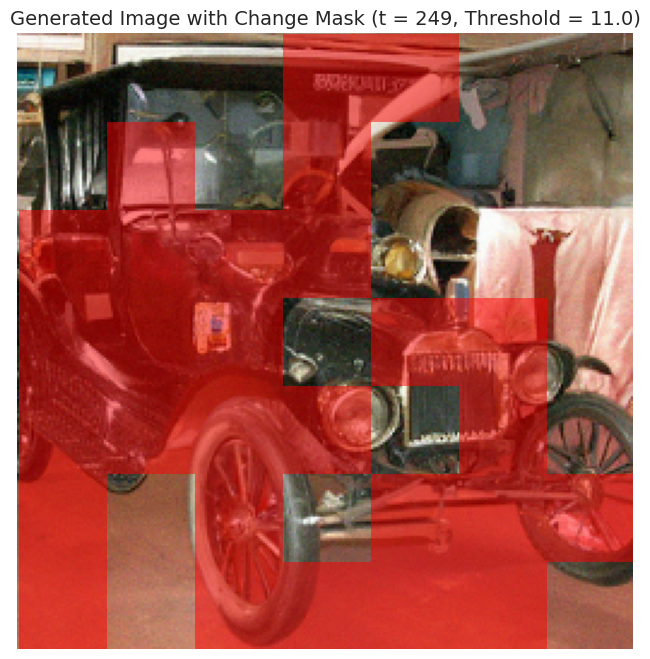

In [37]:
# Select a time step to visualize from the ones you loaded
# time_step_to_show = 300 # Change this to 100, 200, etc.
time_step_to_show = max(all_embeddings.keys()) # Default to the highest noise level

if time_step_to_show not in all_embeddings:
    print(f"❌ Error: Time step {time_step_to_show} not found in loaded data.")
else:
    # 1. Get the specific embeddings for the chosen sample and time step
    start_token = all_embeddings[time_step_to_show]['start'][SAMPLE_INDEX]
    final_token = all_embeddings[time_step_to_show]['final'][SAMPLE_INDEX]
    
    # 2. Calculate the difference map (L2 norm of the difference)
    # This directly replicates the analysis from the paper
    diff_map = torch.norm(final_token - start_token, dim=-1).reshape(7, 7)
    
    # 3. Threshold the map to get a binary mask of "changed" patches
    change_mask = (diff_map > DIFF_THRESHOLD).int()
    
    # 4. Load the image to display
    img_to_show = all_images[time_step_to_show]['final']

    # 5. Create the plot
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(img_to_show)
    ax.set_title(f"Generated Image with Change Mask (t = {time_step_to_show}, Threshold = {DIFF_THRESHOLD})", fontsize=14)
    ax.axis('off')

    # 6. Draw the red rectangles based on the change mask
    height, width = img_to_show.size
    patch_size_h, patch_size_w = height / 7, width / 7

    for row in range(7):
        for col in range(7):
            if change_mask[row, col] == 1:
                rect = plt.Rectangle(
                    (col * patch_size_w, row * patch_size_h), # (x, y)
                    patch_size_w, patch_size_h,
                    facecolor='red', alpha=0.5, edgecolor=None
                )
                ax.add_patch(rect)
    
    plt.show()

✅ Flip-aware figure saved successfully to: /home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-09-15-11-24-21-652901/trajectory_plot_sample_0_flip_aware.png


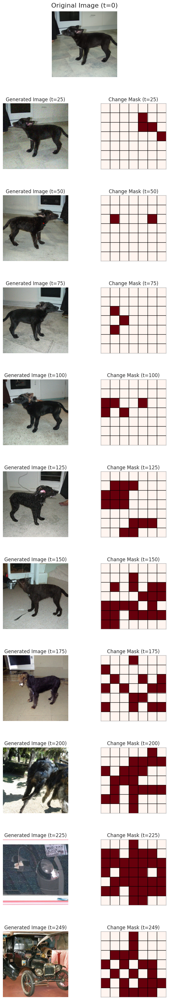

In [38]:
# Cell 5: Visualization 2 - Side-by-Side Comparison (with Flip-Aware Fix)
import matplotlib.gridspec as gridspec
import torchvision.transforms.functional as TF # For the hflip function

if not all_images:
    print("No images loaded to display.")
else:
    time_steps = list(all_images.keys())
    num_steps = len(time_steps)
    
    fig = plt.figure(figsize=(8, 4 * (num_steps + 1)))
    gs = gridspec.GridSpec(num_steps + 1, 2, figure=fig, hspace=0.4)
    
    # Plot the Original Image in the top row, spanning both columns
    ax_orig = fig.add_subplot(gs[0, :])
    original_img = all_images[time_steps[0]]['start']
    ax_orig.imshow(original_img)
    ax_orig.set_title("Original Image (t=0)", fontsize=16, pad=10)
    ax_orig.axis('off')

    # Loop through the time steps for the main grid
    for i, t in enumerate(time_steps):
        ax_img = fig.add_subplot(gs[i + 1, 0])
        ax_map = fig.add_subplot(gs[i + 1, 1])

        # --- Left Column: Generated Image ---
        final_img = all_images[t]['final']
        ax_img.imshow(final_img)
        ax_img.set_title(f"Generated Image (t={t})")
        ax_img.axis('off')

        # --- Right Column: Change Mask (with Flip-Aware Comparison) ---
        start_token = all_embeddings[t]['start'][SAMPLE_INDEX]
        final_token = all_embeddings[t]['final'][SAMPLE_INDEX]
        
        # --- THE FIX IS HERE ---
        # 1. Calculate the difference map for the original orientation.
        diff_map_original = torch.norm(final_token - start_token, dim=-1).reshape(7, 7)

        # 2. The CLIP embeddings are for a 7x7 grid. Flipping the image horizontally
        #    is equivalent to flipping the grid of embeddings horizontally.
        start_token_flipped = torch.fliplr(start_token.reshape(7, 7, -1)).reshape(49, -1)
        diff_map_flipped = torch.norm(final_token - start_token_flipped, dim=-1).reshape(7, 7)

        # 3. The true difference is the MINIMUM of the two comparisons.
        diff_map = torch.minimum(diff_map_original, diff_map_flipped)
        # --- END OF FIX ---
        
        change_mask = (diff_map > DIFF_THRESHOLD)
        
        im = ax_map.imshow(change_mask, cmap='Reds', vmin=0, vmax=1)
        ax_map.set_title(f"Change Mask (t={t})")
        
        ax_map.set_xticks(np.arange(-.5, 7, 1), minor=True)
        ax_map.set_yticks(np.arange(-.5, 7, 1), minor=True)
        ax_map.grid(which="minor", color="black", linestyle='-', linewidth=1)
        ax_map.tick_params(which="minor", size=0)
        ax_map.set_xticks([])
        ax_map.set_yticks([])

    save_path = os.path.join(RESULTS_DIR, f"trajectory_plot_sample_{SAMPLE_INDEX}_flip_aware.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight', pad_inches=0.1)
    print(f"✅ Flip-aware figure saved successfully to: {save_path}")

    plt.show()

In [ ]:
RESULTS_DIR = "/home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-12-18-14-12-37-321303"


In [ ]:
python classifier_statistics.py --classifier_name convnext_base --num_samples 100 --batch_size 100 --data_dir /home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-09-15-11-24-21-652901


In [ ]:
folder = "/work/pcsl/Noam/diffusion_datasets/selected_images"   #ILSVRC2012_val_00000729"


In [ ]:
python classifier_statistics.py --classifier_name convnext_base --data_dir /work/pcsl/Noam/diffusion_datasets/selected_images


python classifier_statistics.py --classifier_name convnext_base --num_samples 100 --batch_size 100 --data_dir /work/pcsl/Noam/diffusion_datasets/selected_images




python evaluate_classifier.py --classifier_name convnext_base --starting_data_dir /work/pcsl/Noam/diffusion_datasets/selected_images --time_series 125 --batch_size 100




python evaluate_classifier_paired.py --classifier_name convnext_base --results_dir /home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/results/forw_back_uncond/2025-12-18-14-12-37-321303



In [25]:
import pickle

file_path = '/home/nlevi/Noam/SingleMaskDiffusion/guided-diffusion/scripts/classifier_statistics/convnext_base/act_stat_convnext_base.pk'

try:
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    
    print("✅ File loaded successfully with pickle!")
    print(f"Data Type: {type(data)}")
    
    if isinstance(data, dict):
        print("Keys:", data.keys())
        
except Exception as e:
    print(f"❌ Pickle load failed: {e}")

✅ File loaded successfully with pickle!
Data Type: <class 'dict'>
Keys: dict_keys(['args', 'accuracy', 'accuracy_top5', 'activations_mean', 'activations_var', 'activations_size'])


In [27]:
data['accuracy']
# data['activations_size']

0.0

In [ ]:
python dataset_sample-forw_back.py --num_samples 100 --batch_size 10
